In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import os
import plotly.express as px
from matplotlib.lines import Line2D  
import numpy as np

In [2]:
df_gps = pd.read_csv("data/gps_lab4.csv", delimiter=',', skiprows=0, low_memory=False)
print(df_gps.shape)
df_gps['field.header.stamp'] = df_gps['field.header.stamp']/(10**9)
df_stat = df_gps[:][:40]
df_circle = df_gps[:][50:100]
df_move = df_gps[:][210:780]
gps_timestamp = [df_gps['field.header.stamp'][40], df_gps['field.header.stamp'][150], df_gps['field.header.stamp'][210], df_gps['field.header.stamp'][780]]
print(df_gps)

(802, 11)
                   %time  field.header.seq  field.header.stamp  \
0    1698242518800186489                27        1.698243e+09   
1    1698242519799914689                28        1.698243e+09   
2    1698242520801061651                29        1.698243e+09   
3    1698242521799608035                30        1.698243e+09   
4    1698242522797393083                31        1.698243e+09   
..                   ...               ...                 ...   
797  1698243316230557437               824        1.698243e+09   
798  1698243317230935212               825        1.698243e+09   
799  1698243318230653823               826        1.698243e+09   
800  1698243319231078404               827        1.698243e+09   
801  1698243320230871897               828        1.698243e+09   

    field.header.frame_id  field.latitude  field.longitude  field.altitude  \
0              GPS1_Frame       42.337086       -71.089867            14.0   
1              GPS1_Frame       42.337086

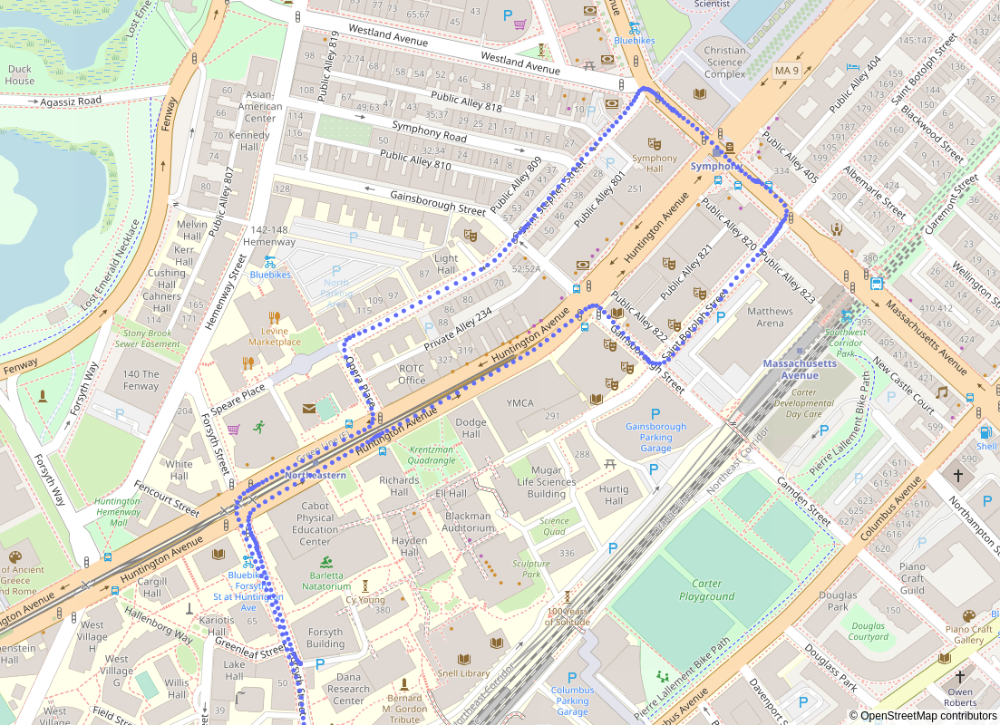

In [3]:
fig = px.scatter_mapbox(df_move, 
                        lat="field.latitude", 
                        lon="field.longitude", 
                        hover_name="field.header.stamp", 
                        zoom=16, 
                        height=800,
                        width=800)

fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [4]:
df_im = pd.read_csv("data/imu_lab4.csv", delimiter=',', skiprows=0, low_memory=False)
df_im['field.Header.stamp'] = df_im['field.Header.stamp']/(10**9)
print(df_im.keys())


Index(['%time', 'field.Header.seq', 'field.Header.stamp',
       'field.Header.frame_id', 'field.IMU.orientation.x',
       'field.IMU.orientation.y', 'field.IMU.orientation.z',
       'field.IMU.orientation.w', 'field.IMU.angular_velocity.x',
       'field.IMU.angular_velocity.y', 'field.IMU.angular_velocity.z',
       'field.IMU.linear_acceleration.x', 'field.IMU.linear_acceleration.y',
       'field.IMU.linear_acceleration.z', 'field.MagField.magnetic_field.x',
       'field.MagField.magnetic_field.y', 'field.MagField.magnetic_field.z'],
      dtype='object')


In [5]:
# Function to find the biggest number <= target number


def find_closest_number(arr, target):
    return np.argmax(arr[arr <= target])

results = []
# Apply the function to the list of keys using list comprehension
for key in gps_timestamp:
    results.append(find_closest_number(df_im['field.Header.stamp'], key))
    # print(key)

print(results)
# print(df_imu['field.Header.stamp'])

[1624, 6024, 8424, 31224]


In [6]:
df_imu = df_im[:][8424:31224]

df_stat = df_im[:][:1624]

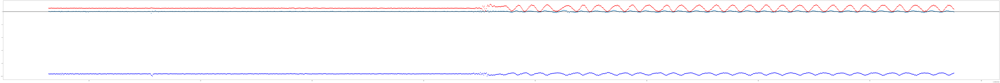

In [7]:
plt.figure(figsize=(200,16))
plt.scatter(x=df_stat['field.Header.stamp'], y=df_stat['field.IMU.linear_acceleration.x'])
plt.scatter(x=df_stat['field.Header.stamp'], y=df_stat['field.IMU.linear_acceleration.y'], color='red')
plt.scatter(x=df_stat['field.Header.stamp'], y=df_stat['field.IMU.linear_acceleration.z'], color='blue')
# plt.axis('equal')
plt.axhline(0, color='black', linewidth=2.5)  # Horizontal line at y=0
plt.show()

(array([3.0000e+00, 1.0000e+00, 5.0000e+00, 1.7000e+01, 3.7000e+01,
        1.6600e+02, 5.6300e+02, 1.7390e+03, 1.3865e+04, 5.2430e+03,
        8.1900e+02, 2.4900e+02, 6.7000e+01, 1.9000e+01, 5.0000e+00,
        2.0000e+00]),
 array([-6.511  , -5.74775, -4.9845 , -4.22125, -3.458  , -2.69475,
        -1.9315 , -1.16825, -0.405  ,  0.35825,  1.1215 ,  1.88475,
         2.648  ,  3.41125,  4.1745 ,  4.93775,  5.701  ]),
 <a list of 16 Patch objects>)

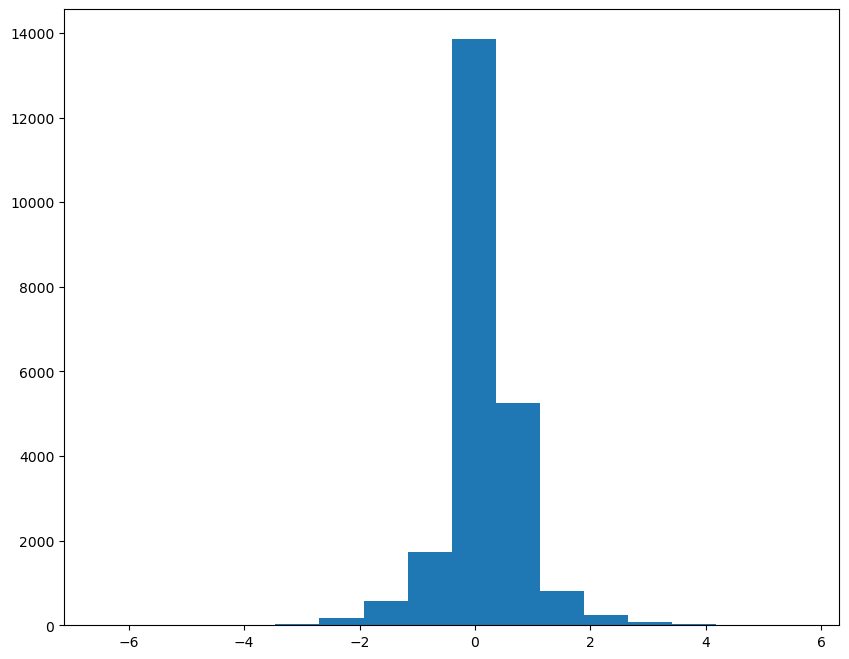

In [8]:
plt.figure(figsize=(10,8))
# plt.scatter(x=df_imu['field.Header.stamp'], y=df_imu['field.IMU.linear_acceleration.y'])
# plt.axis('equal')
# plt.axhline(0, color='black', linewidth=2.5)  # Horizontal line at y=0
# plt.show()
plt.hist(df_imu['field.IMU.linear_acceleration.y'], bins=16)

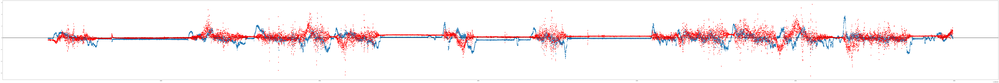

In [9]:
plt.figure(figsize=(200,16))
plt.scatter(x=df_imu['field.Header.stamp'], y=df_imu['field.IMU.linear_acceleration.x'])
plt.scatter(x=df_imu['field.Header.stamp'], y=df_imu['field.IMU.linear_acceleration.y'], color='red')
# plt.axis('equal')
plt.axhline(0, color='black', linewidth=2.5)  # Horizontal line at y=0
plt.show()

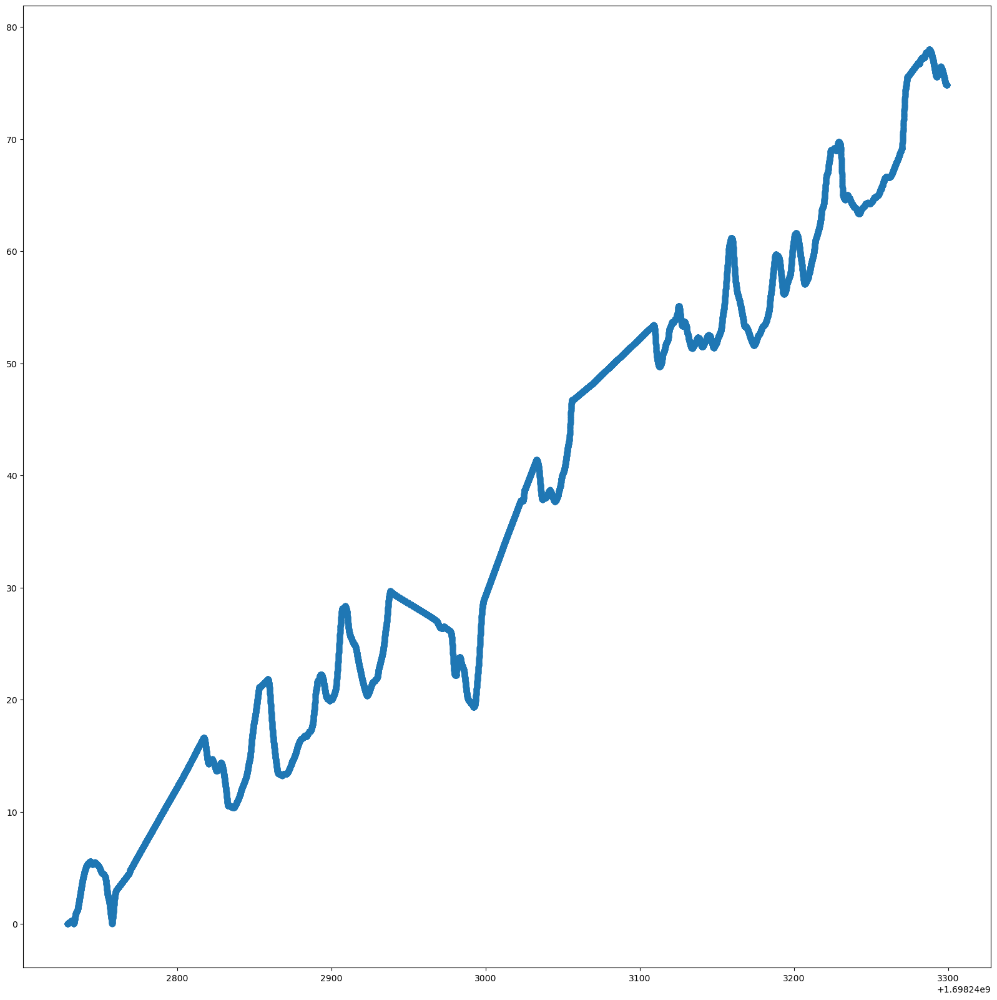

In [10]:
import scipy

acc_x = df_imu['field.IMU.linear_acceleration.x'].to_numpy()
time_s = df_imu['field.Header.stamp'].to_numpy()

lin_vel = scipy.integrate.cumtrapz(acc_x, time_s, initial=0)

df_imu['lin_vel_acc'] = lin_vel
plt.figure(figsize=(20,20))
plt.scatter(x=df_imu['field.Header.stamp'], y=np.abs(df_imu['lin_vel_acc']))

In [11]:
# Calculate displacement in Northing and Easting directions
displacement_northing = np.diff(df_move['field.utm_northing'])
displacement_easting = np.diff(df_move['field.utm_easting'])

# Calculate time differences between consecutive timestamps
time_diff = np.diff(df_move['field.header.stamp'])

# Calculate velocity components
velocity_northing = displacement_northing / time_diff
velocity_easting = displacement_easting / time_diff



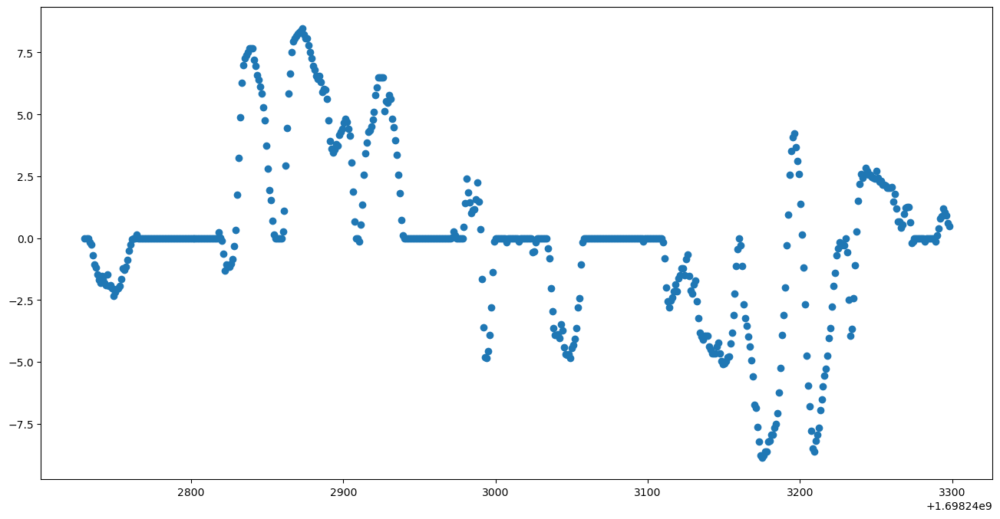

In [12]:
plt.figure(figsize=(16,8))
plt.scatter(x=df_move['field.header.stamp'][1:], y=velocity_easting)

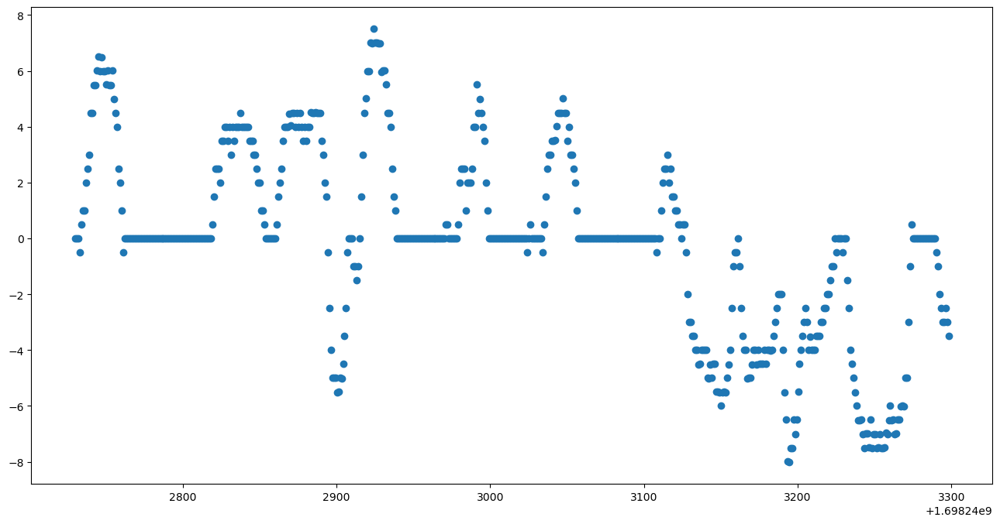

In [13]:
plt.figure(figsize=(16,8))
plt.scatter(x=df_move['field.header.stamp'][1:], y=velocity_northing)

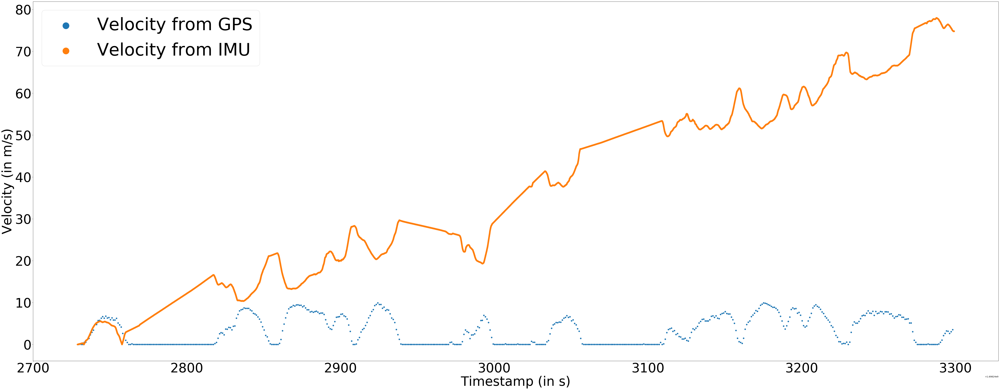

In [14]:
abs_vel = np.sqrt(displacement_northing**2 + displacement_easting**2) / time_diff

plt.figure(figsize=(80,30))
plt.scatter(x=df_move['field.header.stamp'][1:], y=abs_vel, label='Velocity from GPS')
plt.scatter(x=df_imu['field.Header.stamp'], y=np.abs(df_imu['lin_vel_acc']), label='Velocity from IMU')
# Set axis labels with increased font size
plt.xlabel('Timestamp (in s)', fontsize=60)  
plt.ylabel('Velocity (in m/s)', fontsize=60)  

plt.legend(fontsize=80, markerscale=5)

plt.xticks(fontsize=60)  
plt.yticks(fontsize=60) 
plt.savefig('Initial Velocity Estimate')
plt.show()


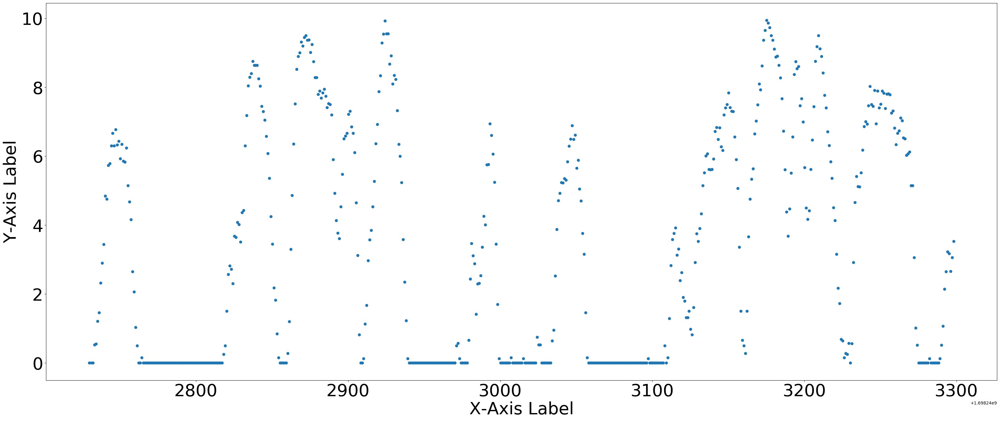

In [15]:
velocity_absolute = np.sqrt(displacement_northing**2 + displacement_easting**2) / time_diff
plt.figure(figsize=(40,16))
plt.scatter(x=df_move['field.header.stamp'][1:], y=abs_vel)
# plt.scatter(x=df_imu['field.Header.stamp'], y=np.abs(df_imu['lin_vel_acc']))
# Set axis labels with increased font size
plt.xlabel('X-Axis Label', fontsize=40)  # Increase font size to 14 for X-axis label
plt.ylabel('Y-Axis Label', fontsize=40)  # Increase font size to 14 for Y-axis label

# Set tick labels with increased font size
plt.xticks(fontsize=40)  # Increase font size to 12 for X-axis tick labels
plt.yticks(fontsize=40) 
plt.show()

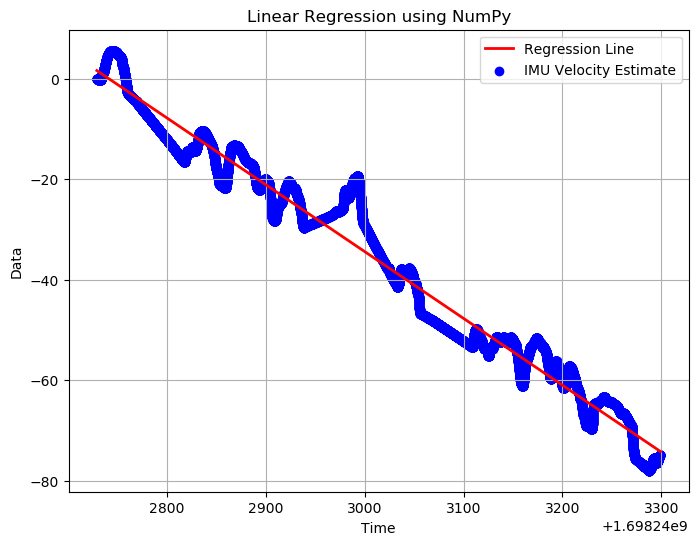

Regression Line Equation: y = -0.13x + 225636812.98


In [16]:
import numpy as np
import matplotlib.pyplot as plt

# Sample time series data (replace these with your actual data)
time = np.array(df_imu['field.Header.stamp'])
data = np.array((df_imu['lin_vel_acc']))

# Perform linear regression using NumPy
coeffs = np.polyfit(time, data, 1)
slope, intercept = coeffs

# Generate points for the regression line
regression_line = slope * time + intercept

# Plot scatter plot and regression line
plt.figure(figsize=(8, 6))
plt.scatter(time, data, color='blue', label='IMU Velocity Estimate')
plt.plot(time, regression_line, color='red', linewidth=2, label='Regression Line')
plt.xlabel('Time')
plt.ylabel('Data')
plt.title('Linear Regression using NumPy')
plt.legend()
plt.grid(True)
plt.savefig("Regression on velocity estimate")
plt.show()

# Print the equation of the regression line
print(f'Regression Line Equation: y = {slope:.2f}x + {intercept:.2f}')


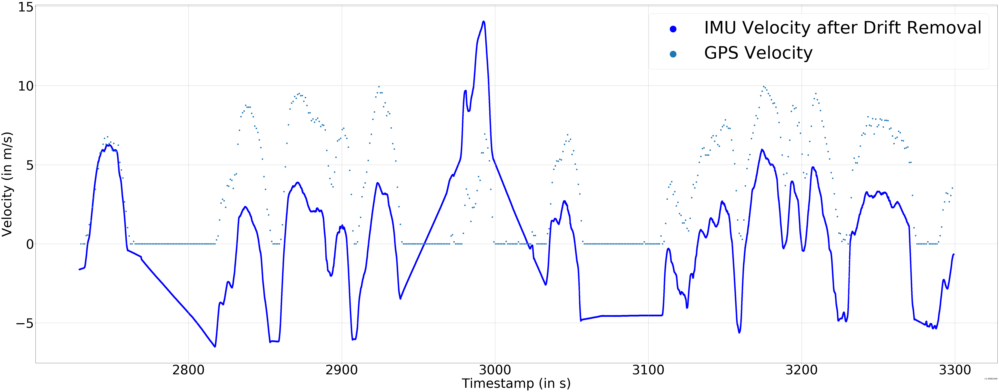

In [17]:
# Removing Drift
df_imu['corr_vel_acc']=((df_imu['lin_vel_acc'])-(slope*time)-intercept)

plt.figure(figsize=(80, 30))
plt.scatter(time, df_imu['corr_vel_acc'], color='blue', label='IMU Velocity after Drift Removal')
plt.xlabel('Timestamp (in s))')
plt.ylabel('Velocity (in m/s)')
plt.scatter(x=df_move['field.header.stamp'][1:], y=abs_vel, label='GPS Velocity')
plt.legend(fontsize=80, markerscale=5)
plt.xlabel('Timestamp (in s)', fontsize=60)  
plt.ylabel('Velocity (in m/s)', fontsize=60)  

plt.xticks(fontsize=60)  
plt.yticks(fontsize=60) 
plt.grid(True)
plt.savefig('IMU Velocity after Drift Removal')
plt.show()



In [18]:
y=df_imu['corr_vel_acc'] 
x=time

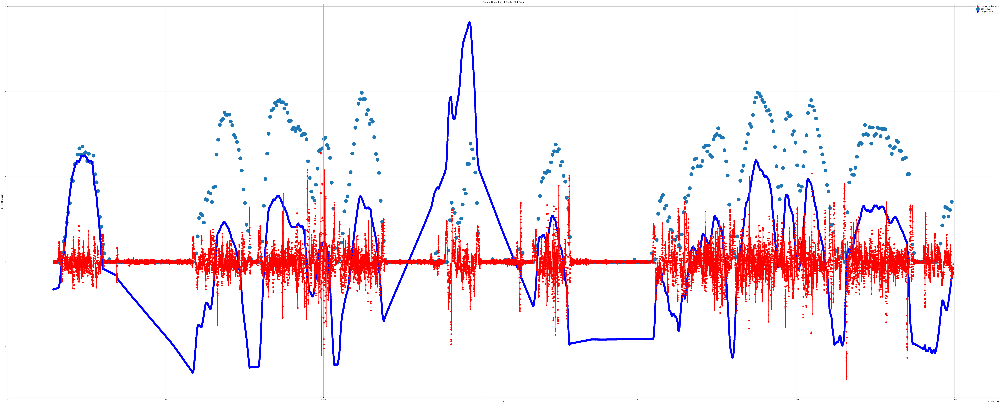

In [19]:
# Calculate second derivative using central difference method
second_derivative = np.gradient(np.gradient(y, x), x[1] - x[0])
# Apply a low-pass filter using a moving average 
window_size = 16 
second_derivative_1 = np.convolve(second_derivative, np.ones(window_size) / window_size, mode='same')


plt.figure(figsize=(100, 40))
plt.plot(x, second_derivative_1, marker='o', color='r', markersize=8, label='Second Derivative')
plt.scatter(x=df_move['field.header.stamp'][1:], y=abs_vel, label='GPS Velocity', s=400)
plt.scatter(x, y=df_imu['corr_vel_acc'], label='Original Data', color='b', s=100)  # Increase the size of the markers (s=100)
plt.xlabel('X')
plt.ylabel('Second Derivative')
plt.title('Second Derivative of Scatter Plot Data')
plt.legend()
plt.grid(True)
plt.show()

In [20]:

min_consecutive_points = 250

# Find sections where y=0 within the threshold with a minimum of 60 consecutive points
y= second_derivative
threshold = 2.5  # Adjust this based on your tolerance level

# Find sections where y=0 within the threshold with a minimum of 60 consecutive points
sections = []
start_idx = None

for i, y_value in enumerate(y):
    if np.abs(y_value) <= threshold:
        if start_idx is None:
            start_idx = i
    else:
        if start_idx is not None:
            if i - start_idx >= min_consecutive_points:
                sections.append((start_idx, i - 1))
            start_idx = None

# Check if the last section extends to the end of the data
if start_idx is not None and len(y) - start_idx >= min_consecutive_points:
    sections.append((x[start_idx], x[-1]))

# Print start and end points of the sections
for section in sections:
    start_point = section[0]
    end_point = section[1]
    print(f"Section: Start Point - {start_point}, End Point - {end_point}")


Section: Start Point - 1247, End Point - 1588
Section: Start Point - 1606, End Point - 3509
Section: Start Point - 8372, End Point - 9748
Section: Start Point - 10788, End Point - 11504
Section: Start Point - 11508, End Point - 11802
Section: Start Point - 11856, End Point - 12143
Section: Start Point - 13132, End Point - 15177
Section: Start Point - 21787, End Point - 22053


In [21]:
plt.figure(figsize=(200, 40))

for section in sections:
    start_idx, end_idx = section
    plt.plot(x[start_idx:end_idx+1], y[start_idx:end_idx+1], marker='o' , linewidth=40)

plt.plot(x, y, marker='o', linestyle='--', color='gray', label='2nd derivative of Forward Velocity')
# plt.scatter(time, df_imu['corr_vel_acc'], color='blue', label='IMU Velocity')

plt.xlabel('Timestamp (in s)', fontsize=100)
plt.ylabel('2nd derivative of Forward Velocity (in m/s3)', fontsize=100)
plt.title('Identifying sections with 2nd derivative = 0 ', fontsize=100)

plt.xticks(fontsize=100)  
plt.yticks(fontsize=100) 
plt.grid(True)
plt.savefig('Drift Area Identification')
plt.show()

In [22]:
plt.figure(figsize=(200, 40))
lin_x = np.array(df_imu['corr_vel_acc'])
for section in sections:
    start_idx, end_idx = section
    lin_x[end_idx+1:] -= lin_x[end_idx]
    lin_x[start_idx:end_idx] =0


lin_x = np.clip(lin_x, 0,100)


plt.scatter(time, lin_x, color='blue', s=200, label='IMU Linear Velocity after correction')
plt.scatter(x=df_move['field.header.stamp'][1:], y=abs_vel, s=400, color='r', label='Velocity from GPS')
plt.xlabel('Timestamp (in s)', fontsize=100) 
plt.ylabel('Velocity (in m/s)', fontsize=100) 
plt.legend(fontsize=120, markerscale=5)

plt.xticks(fontsize=100)  
plt.yticks(fontsize=100) 
plt.savefig('Velocity correction')
plt.show()

# DEAD RECKONING

In [23]:
df_imu['vel_x'] = lin_x
print(df_imu['vel_x'])

8424     0.000000
8425     0.000000
8426     0.000000
8427     0.000000
8428     0.000000
           ...   
31219    4.451947
31220    4.454615
31221    4.455334
31222    4.454232
31223    4.454776
Name: vel_x, Length: 22800, dtype: float64


In [24]:
from tf.transformations import euler_from_quaternion, quaternion_from_euler
from geometry_msgs.msg import Quaternion

# print(df_mag['field.IMU.orientation.w'])
q=Quaternion()
roll =[]
pitch =[]
yaw=[]
for i in range(0, len(df_imu['field.IMU.orientation.x'])):
    q.x = df_imu['field.IMU.orientation.x'].iloc[i]
    q.y =  df_imu['field.IMU.orientation.y'].iloc[i]
    q.z = df_imu['field.IMU.orientation.z'].iloc[i]
    q.w =  df_imu['field.IMU.orientation.w'].iloc[i]
    qlist = [q.x, q.y, q.z, q.w]
    (r, p, y) = euler_from_quaternion(qlist)
    roll.append(r)
    pitch.append(p)
    yaw.append(y)

df_imu['yaw'] =yaw
    

In [25]:
df_imu['acc_y'] = df_imu['field.IMU.angular_velocity.z']*df_imu['vel_x']
print(df_imu['acc_y'])

8424     0.000000
8425     0.000000
8426     0.000000
8427     0.000000
8428    -0.000000
           ...   
31219    0.669951
31220    0.647496
31221    0.626915
31222    0.628550
31223    0.633220
Name: acc_y, Length: 22800, dtype: float64


In [26]:
plt.figure(figsize=(200, 40))

plt.scatter(x=df_imu['field.Header.stamp'], y=df_imu['acc_y'], color='blue', s=400, label='Dead Reckoning')
plt.scatter(x=df_imu['field.Header.stamp'], y=df_imu['field.IMU.linear_acceleration.y'], s=200, color='green', label='IMU')

plt.xlabel('Timestamp (in s)', fontsize=100) 
plt.ylabel('Linear Acceleration y(in m/s)', fontsize=100) 
plt.legend(fontsize=120, markerscale=5)

plt.xticks(fontsize=100)  
plt.yticks(fontsize=100) 
plt.savefig('Y Acceleration')
plt.show()

### GPS Plot of the trajectory

In [27]:
plt.figure(figsize=(100, 100))  # Set the figure size
plt.scatter(df_move['field.utm_easting'], df_move['field.utm_northing'], color='b',s=200, label='Data Points')  # Scatter plot
plt.xlabel('Easting')  # X-axis label
plt.ylabel('Northing')  # Y-axis label
plt.title('Scatter Plot of Easting vs Northing')  # Plot title
plt.legend()  # Show legend
plt.grid(True)  # Show grid
plt.show()  # Display the plot

In [28]:
df_imu['g_velx'] =df_imu['vel_x']*np.sin(df_imu['yaw'])
df_imu['g_vely'] =df_imu['vel_x']*np.cos(df_imu['yaw'])

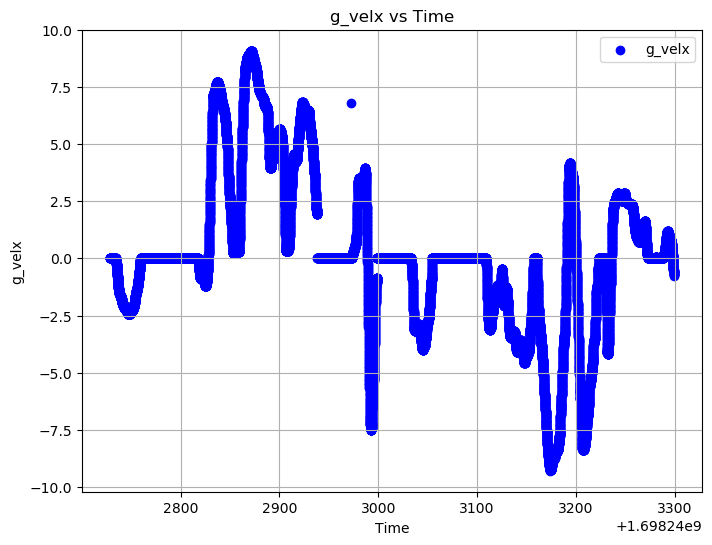

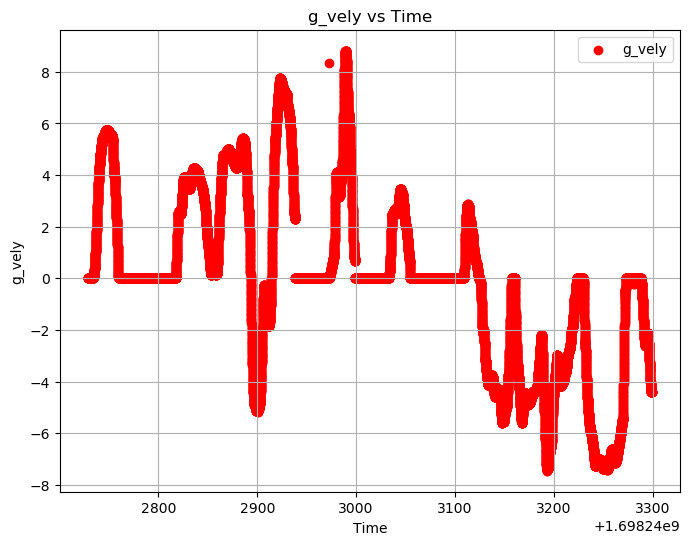

In [29]:
plt.figure(figsize=(8, 6))
plt.scatter(df_imu['field.Header.stamp'], df_imu['g_velx'], color='b', label='g_velx')
plt.xlabel('Time')
plt.ylabel('g_velx')
plt.title('g_velx vs Time')
plt.legend()
plt.grid(True)
plt.show()

# Plot g_vely vs time using scatter plot
plt.figure(figsize=(8, 6))
plt.scatter(df_imu['field.Header.stamp'], df_imu['g_vely'], color='r', label='g_vely')
plt.xlabel('Time')
plt.ylabel('g_vely')
plt.title('g_vely vs Time')
plt.legend()
plt.grid(True)
plt.show()

In [30]:
import scipy

vx = df_imu['g_velx'].to_numpy()
vy = df_imu['g_vely'].to_numpy()
time_s = df_imu['field.Header.stamp'].to_numpy()

px = scipy.integrate.cumtrapz(vx, time_s, initial=0)+df_move['field.utm_easting'].iloc[0]
py = scipy.integrate.cumtrapz(vy, time_s, initial=0)+df_move['field.utm_northing'].iloc[0]
# print(px)

In [31]:
plt.figure(figsize=(100, 100))  # Set the figure size
plt.scatter(px, py, color='b',s=200, label='IMU Dead Reckoning')  # Scatter plot
plt.scatter(df_move['field.utm_easting'], df_move['field.utm_northing'], color='r',s=200, label='GPS Plot') 

plt.xlabel('Easting (in m)', fontsize=100)  # X-axis label
plt.ylabel('Northing (in m)', fontsize=100)  # Y-axis label
plt.scatter(df_move['field.utm_easting'].iloc[0], df_move['field.utm_northing'].iloc[0], color='green', marker='o', s=4000)
plt.title('Scatter Plot of Easting vs Northing')  # Plot title

plt.grid(True)  # Show grid
plt.legend(fontsize=120, markerscale=5)
plt.axis('equal')
plt.xticks(fontsize=80)  
plt.yticks(fontsize=80) 
plt.savefig('Dead Reckoning with IMU Yaw')
plt.show()  # Display the plot

In [32]:
x_off=-0.18245899999999998 
y_off=-0.1006108125
theta = np.radians(147.23769728378366)

In [33]:
df_imu['Mag_x_hard'] = df_imu['field.MagField.magnetic_field.x'] - x_off
df_imu['Mag_y_hard'] = df_imu['field.MagField.magnetic_field.y'] - y_off

In [34]:
df_imu['Magx_rotated'] = (df_imu['Mag_x_hard'] * np.cos(-theta) - df_imu['Mag_y_hard']* np.sin(-theta))/1.25
df_imu['Magy_rotated'] = (df_imu['Mag_x_hard'] * np.sin(-theta) + df_imu['Mag_y_hard']* np.cos(-theta))

In [35]:
df_imu['Mag_yaw'] = np.arctan2(df_imu['Magx_rotated'], df_imu['Magy_rotated'])

In [36]:
import pandas as pd
from scipy.signal import butter, filtfilt
import matplotlib.pyplot as plt

cutoff_frequency = 15 # Cutoff frequency in Hz (adjust as needed)
sampling_frequency = 40  
order = 1  

nyquist_frequency = 0.5 * sampling_frequency

# Calculate normalized cutoff frequency
normalized_cutoff = cutoff_frequency / nyquist_frequency

# Design low-pass filter using Butterworth filter
b, a = butter(order, Wn=normalized_cutoff, btype='low')

# Apply the filter to the yaw estimates
filtered_yaw = filtfilt(b, a, df_imu['Mag_yaw'])

df_imu['filtered_yaw_mag'] = filtered_yaw

In [37]:
angular_velocity_z = df_imu['field.IMU.angular_velocity.z'] 
dt = 0.025 

integrated_yaw = np.cumsum(angular_velocity_z) * dt

wrapped_yaw = np.mod(integrated_yaw + np.pi, 2 * np.pi) - np.pi

df_imu['yaw_int'] = wrapped_yaw

In [38]:
a=0.85
df_imu['Yaw_com'] =  np.mod(((a * df_imu['yaw_int']) + ((1-a)*df_imu['filtered_yaw_mag']))+ np.pi, 2 * np.pi) - np.pi

In [39]:
df_imu['g_velx'] =df_imu['vel_x']*np.sin(df_imu['Yaw_com'])
df_imu['g_vely'] =df_imu['vel_x']*np.cos(df_imu['Yaw_com'])

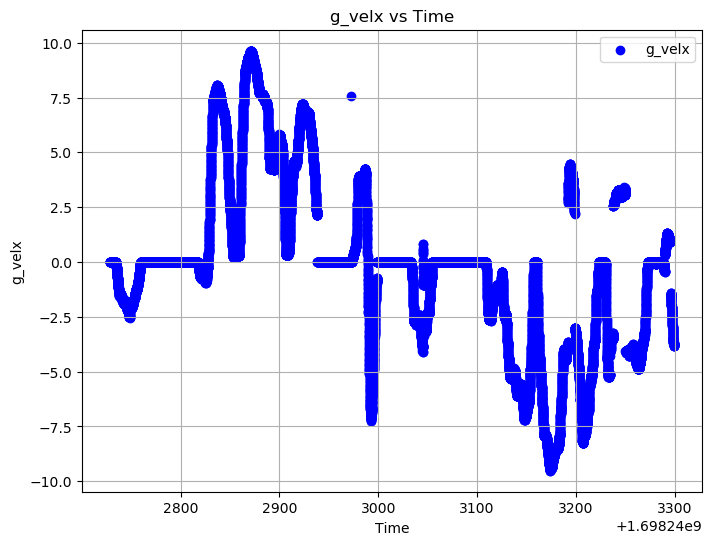

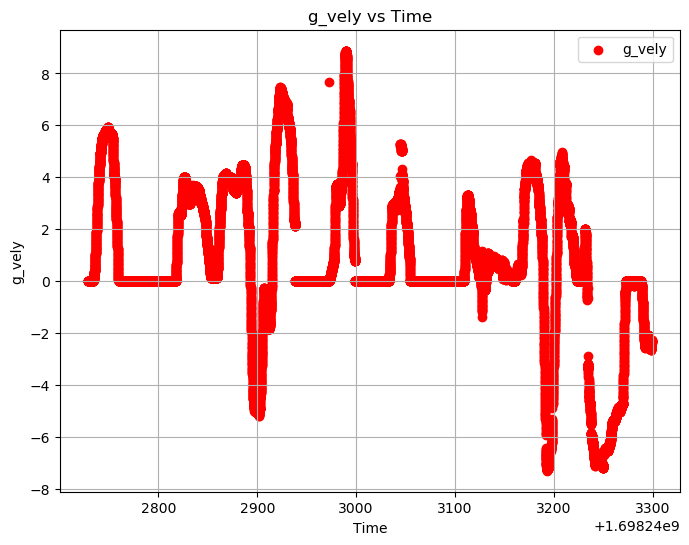

In [40]:
plt.figure(figsize=(8, 6))
plt.scatter(df_imu['field.Header.stamp'], df_imu['g_velx'], color='b', label='g_velx')
plt.xlabel('Time')
plt.ylabel('g_velx')
plt.title('g_velx vs Time')
plt.legend()
plt.grid(True)
plt.show()

# Plot g_vely vs time using scatter plot
plt.figure(figsize=(8, 6))
plt.scatter(df_imu['field.Header.stamp'], df_imu['g_vely'], color='r', label='g_vely')
plt.xlabel('Time')
plt.ylabel('g_vely')
plt.title('g_vely vs Time')
plt.legend()
plt.grid(True)
plt.show()

In [41]:
import scipy

vx = df_imu['g_velx'].to_numpy()
vy = df_imu['g_vely'].to_numpy()
time_s = df_imu['field.Header.stamp'].to_numpy()

px = scipy.integrate.cumtrapz(vx, time_s, initial=0)+df_move['field.utm_easting'].iloc[0]
py = scipy.integrate.cumtrapz(vy, time_s, initial=0)+df_move['field.utm_northing'].iloc[0]
# print(px)

In [42]:
plt.figure(figsize=(100, 100))  # Set the figure size
plt.scatter(px, py, color='b',s=200, label='Dead Reckoning with Complimentary filter Yaw')
plt.scatter(df_move['field.utm_easting'], df_move['field.utm_northing'], color='r',s=200, label='GPS Plot') 
plt.xlabel('Easting')  
plt.ylabel('Northing') 
plt.title('Scatter Plot of Easting vs Northing')  # Plot title

plt.scatter(df_move['field.utm_easting'].iloc[0], df_move['field.utm_northing'].iloc[0], color='green', marker='o', s=4000)

plt.grid(True)  # Show grid
plt.legend(fontsize=120, markerscale=5)
plt.axis('equal')
plt.xlabel('Easting (in m)', fontsize=80) 
plt.ylabel('Northing (in m)', fontsize=80) 
plt.xticks(fontsize=80)  
plt.yticks(fontsize=80) 
plt.savefig('Dead Reckoning with Calculated Yaw')
plt.show()  # Display the plot